In [103]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [104]:
data_frame = pd.read_csv('database.csv')

In [105]:
data_frame.head()

,Date,Time,Latitude,Longitude,Type,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Type,...,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square,ID,Source,Location Source,Magnitude Source,Status
0,01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6,NaN,NaN,6.0,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860706,ISCGEM,ISCGEM,ISCGEM,Automatic
1,01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860737,ISCGEM,ISCGEM,ISCGEM,Automatic
2,01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0,NaN,NaN,6.2,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860762,ISCGEM,ISCGEM,ISCGEM,Automatic
3,01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860856,ISCGEM,ISCGEM,ISCGEM,Automatic
4,01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0,NaN,NaN,5.8,MW,...,NaN,NaN,NaN,NaN,NaN,ISCGEM860890,ISCGEM,ISCGEM,ISCGEM,Automatic


In [106]:
data_frame.shape

(23409, 21)

In [107]:
data_frame = data_frame[['Date','Time','Latitude','Longitude','Type','Depth']]

In [108]:
data_frame.head()

,Date,Time,Latitude,Longitude,Type,Depth
0,01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6
1,01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0
2,01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0
3,01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0
4,01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0


In [109]:
data_frame['year'] = data_frame['Date'].str[6:10]

In [110]:
data_frame['year'] = data_frame['year'].astype(int)

In [111]:
data_frame.head()

,Date,Time,Latitude,Longitude,Type,Depth,year
0,01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6,1965
1,01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0,1965
2,01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0,1965
3,01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0,1965
4,01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0,1965


In [112]:
from folium.plugins import HeatMapWithTime
import folium
import mpl_toolkits
from mpl_toolkits.basemap import Basemap # library to plot maps
from branca.element import Figure

In [113]:
lat_long_list = []
for i in range(0,len(data_frame)):
    temp=[]
    for index, instance in data_frame[data_frame['year'] == i].iterrows():
        temp.append([instance['Latitude'],instance['Longitude']])
        lat_long_list.append(temp)

In [114]:
lat_long_small = lat_long_list[0:3000]

In [115]:
lat_long_small

[[[19.246, 145.616],
  [1.863, 127.352],
  [-20.579, -173.972],
  [-59.076, -23.557],
  [11.938, 126.427],
  [-13.405, 166.629],
  [27.357, 87.867],
  [-13.309, 166.212],
  [-56.452, -27.043],
  [-24.563, 178.487],
  [-6.807, 108.988],
  [-2.608, 125.952],
  [54.636, 161.703],
  [-18.697, -177.864],
  [37.523, 73.251],
  [-51.84, 139.741],
  [51.251, 178.715],
  [51.639, 175.055],
  [52.528, 172.007],
  [51.626, 175.746],
  [51.037, 177.848],
  [51.73, 173.975],
  [51.775, 173.058],
  [52.611, 172.588],
  [51.831, 174.368],
  [51.948, 173.969],
  [51.443, 179.605],
  [52.773, 171.974],
  [51.772, 174.696],
  [52.975, 171.091],
  [52.99, 170.874],
  [51.536, 175.045],
  [13.245, -44.922],
  [51.812, 174.206],
  [51.762, 174.841],
  [52.438, 174.321],
  [51.946, 173.84],
  [51.738, 174.566],
  [51.487, 176.558],
  [53.008, -162.008],
  [52.184, 175.505],
  [52.076, 172.918],
  [51.744, 175.213],
  [52.057, 174.116],
  [53.191, -161.859],
  [51.447, 176.469],
  [51.258, 173.393],
  [52.03

Text(0.5, 1.0, 'Heatmap of all meteorite impacts')

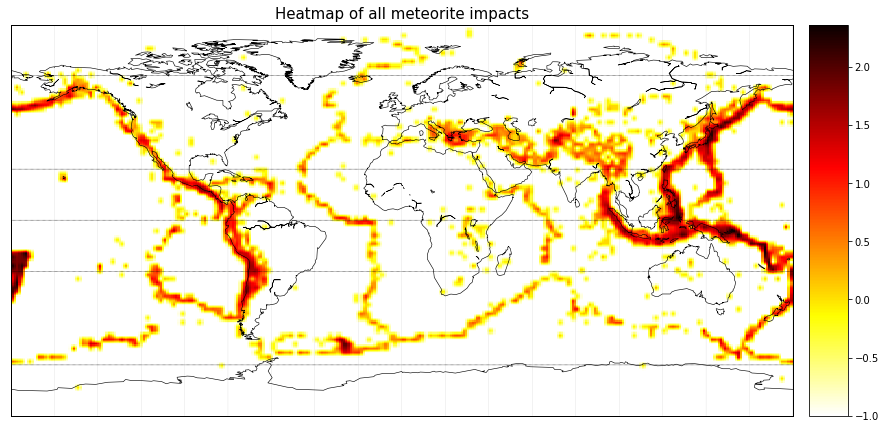

In [116]:
plt.figure(figsize=(15,12))
h = plt.hist2d(data_frame.Longitude,data_frame.Latitude,bins=(np.arange(-180,182,2),np.arange(-90,92,2)))
X,Y = np.meshgrid(h[1][:-1]+1.0,h[2][:-1]+1.0)

map = Basemap(projection='cyl')
map.drawmapboundary(fill_color='w')
map.drawcoastlines(linewidth=0.6)
map.drawmeridians(range(0, 360, 20),linewidth=0.1)
map.drawparallels([-66.56083,-23.5,0.0,23.5,66.56083], linewidth=0.6)

data_interp, x, y = map.transform_scalar(np.log10(h[0].T+0.1), X[0], Y[:,0], 360, 360, returnxy=True)
map.pcolormesh(x, y, data_interp,cmap='hot_r')
map.colorbar()
plt.title('Heatmap of all meteorite impacts', fontsize=15)

In [117]:
# fig=Figure(width=550,height=350)
# fig7=Figure(width=850,height=550)
# m7=folium.Map(location=[19.246, 145.616],zoom_start=2)
# fig7.add_child(m7)

In [118]:
# HeatMapWithTime(lat_long_small,radius=15,auto_play=True,position='bottomright',min_opacity=0.05,max_opacity=1.2,max_speed = 10,speed_step = 2,overlay=True).add_to(m7)
# m7

In [119]:
# m7.save('quake.html')